# 🧠 CycleGAN: Unpaired Image-to-Image Translation

### **Artin Tavasoli**
### 📘 Student ID: 810102543


## 1. Overview
In this project, we implement **CycleGAN**, a powerful technique for translating images from one domain to another (e.g., Apples $\leftrightarrow$ Oranges, Summer $\leftrightarrow$ Winter) **without** paired training data. Unlike Pix2Pix, which requires exact pairs (e.g., a photo of a shoe and the matching sketch), CycleGAN learns to map the distribution of Domain $A$ to Domain $B$ using unpaired collections of images.

The goal is to learn two mappings: $G: X \to Y$ and $F: Y \to X$. We use two discriminators: $D_Y$ (distinguishes real $y$ from generated $G(x)$) and $D_X$ (distinguishes real $x$ from generated $F(y)$).

### A. Adversarial Loss
We use the standard GAN loss to ensure the generated images look realistic. For the mapping $G: X \to Y$:
$$\mathcal{L}_{GAN}(G, D_Y, X, Y) = \mathbb{E}_{y \sim p_{data}(y)}[\log D_Y(y)] + \mathbb{E}_{x \sim p_{data}(x)}[\log(1 - D_Y(G(x)))]$$

### B. Cycle Consistency Loss
To ensure the translation preserves content (e.g., a horse turned into a zebra should still look like the *same* horse if translated back), we enforce cycle consistency: $x \to G(x) \to F(G(x)) \approx x$.
$$\mathcal{L}_{cyc}(G, F) = \mathbb{E}_{x \sim p_{data}(x)}[\|F(G(x)) - x\|_1] + \mathbb{E}_{y \sim p_{data}(y)}[\|G(F(y)) - y\|_1]$$

### C. Identity Loss
To preserve color composition (e.g., in painting generation), we ensure that if we feed a real image from target domain $Y$ into generator $G$ (which translates $X \to Y$), it should remain unchanged: $G(y) \approx y$.
$$\mathcal{L}_{identity}(G, F) = \mathbb{E}_{y \sim p_{data}(y)}[\|G(y) - y\|_1] + \mathbb{E}_{x \sim p_{data}(x)}[\|F(x) - x\|_1]$$
Without this, the generator G and F are free to change the tint of input images when there is no need to.
This becomes essential for Photo $\leftrightarrow$ Monet, In this project we only analyzed Apples $\leftrightarrow$ Oranges, Summer $\leftrightarrow$ Winter, but because it's a good regularization term, we kept it in the loss
### D. Total Loss
The final objective function is a weighted sum of these losses. In this project, we include the identity loss to preserve color composition (essential for the Monet task):

$$\mathcal{L} = \mathcal{L}_{GAN}(G, D_Y, X, Y) + \mathcal{L}_{GAN}(F, D_X, Y, X) + \lambda_{cyc} \mathcal{L}_{cyc}(G, F) + \lambda_{id} \mathcal{L}_{identity}(G, F)$$

Where:
* $\lambda_{cyc} = 10$ 
* $\lambda_{id} = 5$ (We set $\lambda_{id} = 0.5 \times \lambda_{cyc}$)

In [19]:
import gc
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset
import torchvision.transforms as transforms
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
from PIL import Image
import os
import glob
import random
import numpy as np

## 2. Configuration & Dataset
Here we define the configuration loader to handle different datasets (e.g., apple2orange, summer2winter). We also implement the CycleGANDataset class.
* **Unpaired Loading:** The dataset randomly selects an image from Domain A and an image from Domain B. They do not need to correspond to each other.
* **Preprocessing:** We resize images to $128 \times 128$ and normalize them to the range $[-0.5, 0.5]$.

In [20]:
def get_config(dataset_name):
    if dataset_name == "apple2orange":
        path = "/kaggle/input/apple2orange-dataset"
        
    elif dataset_name == "summer2winter":
        path = "/kaggle/input/summer2winter-yosemite"
    
    
    return {
        "DEVICE": "cuda" if torch.cuda.is_available() else "cpu",
        "TRAIN_DIR": path,
        "BATCH_SIZE": 1,
        "LEARNING_RATE": 2e-4,
        "LAMBDA_CYCLE": 10,
        "NUM_WORKERS": 2,
        "NUM_EPOCHS": 20,
        "IMG_SIZE": 128
    }

class CycleGANDataset(Dataset):
    def __init__(self, root_dir, transform=None, mode='train'):
        self.transform = transform
        self.files_A = sorted(glob.glob(os.path.join(root_dir, f'{mode}A') + '/*.*'))
        if len(self.files_A) == 0:
             self.files_A = sorted(glob.glob(os.path.join(root_dir, f'{mode}A') + '*.*'))
             
        self.files_B = sorted(glob.glob(os.path.join(root_dir, f'{mode}B') + '/*.*'))
        if len(self.files_B) == 0:
             self.files_B = sorted(glob.glob(os.path.join(root_dir, f'{mode}B') + '*.*'))

    def __getitem__(self, index):
        img_A = self.files_A[index % len(self.files_A)]
        img_B = self.files_B[random.randint(0, len(self.files_B) - 1)]
        
        img_A = Image.open(img_A).convert('RGB')
        img_B = Image.open(img_B).convert('RGB')

        if self.transform:
            img_A = self.transform(img_A)
            img_B = self.transform(img_B)

        return {'A': img_A, 'B': img_B}

    def __len__(self):
        return max(len(self.files_A), len(self.files_B))

## 3. Model Architecture

### Generator (ResNet-based)
We use a **ResNet-based generator** because it excels at image-to-image translation tasks where the input and output share structure (e.g., apples and oranges have the same shape).
* **Downsampling:** Compresses the image to capture context.
* **Residual Blocks:** 6 blocks (for $128 \times 128$ images) that process features without losing original information.
* **Upsampling:** Reconstructs the transformed image.


In [21]:
class ResidualBlock(nn.Module):
    def __init__(self, channels):
        super().__init__()
        self.block = nn.Sequential(
            nn.ReflectionPad2d(1),
            nn.Conv2d(channels, channels, 3),
            nn.InstanceNorm2d(channels),
            nn.ReLU(inplace=True),
            nn.ReflectionPad2d(1),
            nn.Conv2d(channels, channels, 3),
            nn.InstanceNorm2d(channels)
        )
    def forward(self, x): return x + self.block(x)

class Generator(nn.Module):
    def __init__(self, img_channels=3, num_residuals=6):
        super().__init__()
        layers = [
            nn.ReflectionPad2d(3),
            nn.Conv2d(img_channels, 64, 7),
            nn.InstanceNorm2d(64),
            nn.ReLU(inplace=True)
        ]
        in_channels = 64
        for _ in range(2):
            out_channels = in_channels * 2
            layers.extend([
                nn.Conv2d(in_channels, out_channels, 3, stride=2, padding=1),
                nn.InstanceNorm2d(out_channels),
                nn.ReLU(inplace=True)
            ])
            in_channels = out_channels
        for _ in range(num_residuals):
            layers.append(ResidualBlock(in_channels))
        for _ in range(2):
            out_channels = in_channels // 2
            layers.extend([
                nn.ConvTranspose2d(in_channels, out_channels, 3, stride=2, padding=1, output_padding=1),
                nn.InstanceNorm2d(out_channels),
                nn.ReLU(inplace=True)
            ])
            in_channels = out_channels
        layers.extend([
            nn.ReflectionPad2d(3),
            nn.Conv2d(64, img_channels, 7),
            nn.Tanh()
        ])
        self.model = nn.Sequential(*layers)
    def forward(self, x): return self.model(x)


### Discriminator (PatchGAN)
Instead of classifying the entire image as "Real" or "Fake" (outputting a single number), we use a **PatchGAN**.
* It classifies $70 \times 70$ overlapping patches of the image.
* This forces the generator to focus on high-frequency details (texture and style) rather than just global structure.

In [22]:
class Block(nn.Module):
    def __init__(self, in_channels, out_channels, stride):
        super().__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, 4, stride, 1, bias=True, padding_mode="reflect"),
            nn.InstanceNorm2d(out_channels),
            nn.LeakyReLU(0.2, inplace=True),
        )
    def forward(self, x): return self.conv(x)

class Discriminator(nn.Module):
    def __init__(self, in_channels=3, features=[64, 128, 256, 512]):
        super().__init__()
        layers = []
        layers.append(nn.Sequential(
            nn.Conv2d(in_channels, features[0], 4, 2, 1, padding_mode="reflect"),
            nn.LeakyReLU(0.2, inplace=True),
        ))
        in_channels = features[0]
        for feature in features[1:]:
            layers.append(Block(in_channels, feature, stride=1 if feature == features[-1] else 2))
            in_channels = feature
        layers.append(nn.Conv2d(in_channels, 1, 4, stride=1, padding=1, padding_mode="reflect"))
        self.model = nn.Sequential(*layers)
    def forward(self, x): return self.model(x)

## 4. Training Utilities
* **ReplayBuffer:** Stores previously generated images. We update the discriminator using a history of 50 images rather than just the latest one. This prevents the model from oscillating and stabilizes training.
* **Visualization:** Functions to plot raw data and training progress (Real A, Generated B, Real B, Generated A).

In [ ]:
class ReplayBuffer:
    def __init__(self, max_size=50):
        self.max_size = max_size
        self.data = []
    def push_and_pop(self, data):
        to_return = []
        for element in data.data:
            element = torch.unsqueeze(element, 0)
            if len(self.data) < self.max_size:
                self.data.append(element)
                to_return.append(element)
            else:
                if random.uniform(0, 1) > 0.5:
                    i = random.randint(0, self.max_size - 1)
                    to_return.append(self.data[i].clone())
                    self.data[i] = element
                else:
                    to_return.append(element)
        return torch.cat(to_return)

def initialize_models(config):
    gen_B = Generator(img_channels=3).to(config["DEVICE"])
    gen_A = Generator(img_channels=3).to(config["DEVICE"])
    disc_B = Discriminator(in_channels=3).to(config["DEVICE"])
    disc_A = Discriminator(in_channels=3).to(config["DEVICE"])

    opt_gen = optim.Adam(
        list(gen_B.parameters()) + list(gen_A.parameters()), 
        lr=config["LEARNING_RATE"], betas=(0.5, 0.999)
    )
    opt_disc = optim.Adam(
        list(disc_B.parameters()) + list(disc_A.parameters()), 
        lr=config["LEARNING_RATE"], betas=(0.5, 0.999)
    )

    g_scaler = torch.cuda.amp.GradScaler()
    d_scaler = torch.cuda.amp.GradScaler()
    
    return gen_B, gen_A, disc_B, disc_A, opt_gen, opt_disc, g_scaler, d_scaler

def show_raw_samples(dataset, num_samples=5):
    temp_loader = DataLoader(dataset, batch_size=1, shuffle=True)
    iterator = iter(temp_loader)
    plt.figure(figsize=(10, 2 * num_samples))
    
    for i in range(num_samples):
        batch = next(iterator)
        img_A = batch['A'][0].cpu() * 0.5 + 0.5
        img_B = batch['B'][0].cpu() * 0.5 + 0.5
        
        plt.subplot(num_samples, 2, 2*i + 1)
        plt.imshow(img_A.permute(1, 2, 0).numpy())
        plt.title("Domain A")
        plt.axis("off")
        
        plt.subplot(num_samples, 2, 2*i + 2)
        plt.imshow(img_B.permute(1, 2, 0).numpy())
        plt.title("Domain B")
        plt.axis("off")
        
    plt.suptitle("Raw Dataset Samples (Before Training)", y=1.01, fontsize=16)
    plt.tight_layout()
    plt.show()
    
def save_predictions(gen_B, gen_A, loader, config, epoch, num_samples=5):
    gen_B.eval()
    gen_A.eval()
    iterator = iter(loader)
    plt.figure(figsize=(16, 4 * num_samples)) 
    
    for i in range(num_samples):
        try:
            batch = next(iterator)
        except StopIteration:
            iterator = iter(loader)
            batch = next(iterator)
            
        real_A = batch['A'].to(config['DEVICE']) 
        real_B = batch['B'].to(config['DEVICE']) 
        
        with torch.no_grad():
            fake_B = gen_B(real_A) 
            fake_A = gen_A(real_B) 
        
        img_real_A = real_A[0].cpu() * 0.5 + 0.5
        img_fake_B = fake_B[0].cpu() * 0.5 + 0.5
        img_real_B = real_B[0].cpu() * 0.5 + 0.5
        img_fake_A = fake_A[0].cpu() * 0.5 + 0.5
        
        plt.subplot(num_samples, 4, 4*i + 1); plt.imshow(img_real_A.permute(1,2,0).numpy()); plt.title("Real A"); plt.axis("off")
        plt.subplot(num_samples, 4, 4*i + 2); plt.imshow(img_fake_B.permute(1,2,0).numpy()); plt.title("Gen B"); plt.axis("off")
        plt.subplot(num_samples, 4, 4*i + 3); plt.imshow(img_real_B.permute(1,2,0).numpy()); plt.title("Real B"); plt.axis("off")
        plt.subplot(num_samples, 4, 4*i + 4); plt.imshow(img_fake_A.permute(1,2,0).numpy()); plt.title("Gen A"); plt.axis("off")
        
    plt.tight_layout()
    plt.suptitle(f"Epoch {epoch} Predictions", y=1.01, fontsize=16)
    plt.show()
    gen_B.train()
    gen_A.train()

def plot_five_diagrams(history):
    epochs = range(1, len(history["D_A"]) + 1)
    plt.figure(figsize=(15, 10))
    metrics = [("G_A", "orange"), ("G_B", "orange"), ("Cycle", "green"), ("D_A", "blue"), ("D_B", "blue")]
    for i, (key, color) in enumerate(metrics):
        plt.subplot(2, 3, i+1)
        plt.plot(epochs, history[key], label=key, color=color)
        plt.title(f"{key} Loss")
        plt.xlabel("Epoch")
        plt.legend()
    plt.tight_layout()
    plt.show()

## 5. Training Logic
1.  **Discriminator Step:**
    * Generate fake images ($A \to FakeB$, $B \to FakeA$).
    * Train $D_A$ to distinguish Real A from Fake A.
    * Train $D_B$ to distinguish Real B from Fake B.
    * Loss: MSE (Least Squares GAN).
2.  **Generator Step:**
    * **Adversarial Loss:** Trick $D_A$ and $D_B$ into thinking fakes are real.
    * **Cycle Loss:** $A \to FakeB  \to  RecA \approx RealA$ (and vice versa). Loss: L1.
    * **Identity Loss:** $A \to GenA \approx A$ (preserves color). Loss: L1.

In [ ]:
def train_fn(disc_A, disc_B, gen_B, gen_A, loader, opt_disc, opt_gen, l1, mse, d_scaler, g_scaler, buffer_A, buffer_B, config):
    loop = tqdm(loader, leave=True)
    
    loss_stats = {"D_A": 0.0, "D_B": 0.0, "G_A": 0.0, "G_B": 0.0, "Cycle": 0.0}
    count = 0
    
    for idx, batch in enumerate(loop):
        real_A = batch['A'].to(config['DEVICE'])
        real_B = batch['B'].to(config['DEVICE'])
        
        with torch.cuda.amp.autocast():
            fake_A = gen_A(real_B) 
            fake_B = gen_B(real_A)
            
            D_A_real = disc_A(real_A)
            fake_A_ = buffer_A.push_and_pop(fake_A)
            D_A_fake = disc_A(fake_A_.detach())
            D_A_loss = (mse(D_A_real, torch.ones_like(D_A_real)) + mse(D_A_fake, torch.zeros_like(D_A_fake))) * 0.5
            
            D_B_real = disc_B(real_B)
            fake_B_ = buffer_B.push_and_pop(fake_B)
            D_B_fake = disc_B(fake_B_.detach())
            D_B_loss = (mse(D_B_real, torch.ones_like(D_B_real)) + mse(D_B_fake, torch.zeros_like(D_B_fake))) * 0.5
            
            D_total_loss = D_A_loss + D_B_loss

        opt_disc.zero_grad()
        d_scaler.scale(D_total_loss).backward()
        d_scaler.step(opt_disc)
        d_scaler.update()

        with torch.cuda.amp.autocast():
            D_A_fake = disc_A(fake_A)
            loss_G_A = mse(D_A_fake, torch.ones_like(D_A_fake))
            
            D_B_fake = disc_B(fake_B)
            loss_G_B = mse(D_B_fake, torch.ones_like(D_B_fake))
            
            cycle_B = gen_B(fake_A) 
            cycle_A = gen_A(fake_B) 
            loss_cycle = (l1(cycle_B, real_B) + l1(cycle_A, real_A)) * config['LAMBDA_CYCLE']

            id_B = gen_B(real_B)
            id_A = gen_A(real_A)
            loss_id = (l1(id_B, real_B) + l1(id_A, real_A)) * 5.0
            
            G_total_loss = loss_G_A + loss_G_B + loss_cycle + loss_id

        opt_gen.zero_grad()
        g_scaler.scale(G_total_loss).backward()
        g_scaler.step(opt_gen)
        g_scaler.update()
        
        loss_stats["D_A"] += D_A_loss.item()
        loss_stats["D_B"] += D_B_loss.item()
        loss_stats["G_A"] += loss_G_A.item()
        loss_stats["G_B"] += loss_G_B.item()
        loss_stats["Cycle"] += loss_cycle.item()
        count += 1
        
    return {k: v / count for k, v in loss_stats.items()}

def run_training(config, train_loader, val_loader):
    gen_B, gen_A, disc_B, disc_A, opt_gen, opt_disc, g_scaler, d_scaler = initialize_models(config)
    
    buffer_B = ReplayBuffer()
    buffer_A = ReplayBuffer()
    l1 = nn.L1Loss()
    mse = nn.MSELoss()
    
    history = {"D_A": [], "D_B": [], "G_A": [], "G_B": [], "Cycle": []}
    
    print(f"Starting Training on {config['TRAIN_DIR']}...")
    for epoch in range(config["NUM_EPOCHS"]):
        stats = train_fn(
            disc_A, disc_B, gen_B, gen_A, 
            train_loader, opt_disc, opt_gen, 
            l1, mse, d_scaler, g_scaler, 
            buffer_A, buffer_B, config
        )
        
        for k in history: 
            history[k].append(stats[k])
            
        print(f"Epoch {epoch+1} | Cycle Loss: {stats['Cycle']:.4f}")
        
        if (epoch+1) in [1, 10, 20]: 
            save_predictions(gen_B, gen_A, val_loader, config, epoch+1)
            
    return history, gen_B, gen_A

## 7. Apple2Orange
We run the training for 20 epochs.
* We display 5 random samples first to familiarize ourselves with Domain A (Apples) and B (Oranges).

Loaded 1019 images.
Visualizing Raw Dataset Samples...


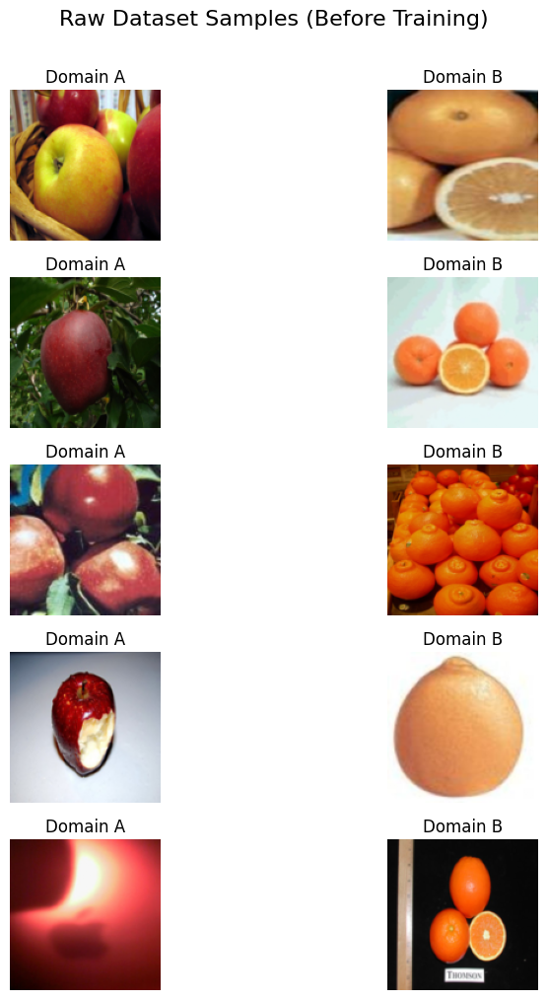

Starting Training on /kaggle/input/apple2orange-dataset...


/tmp/ipykernel_47/2390134110.py:36: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  g_scaler = torch.cuda.amp.GradScaler()
/tmp/ipykernel_47/2390134110.py:37: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  d_scaler = torch.cuda.amp.GradScaler()


  0%|          | 0/1019 [00:00<?, ?it/s]

/tmp/ipykernel_47/2871812625.py:11: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast():
/tmp/ipykernel_47/2871812625.py:32: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast():


Epoch 1 | Cycle Loss: 5.6122


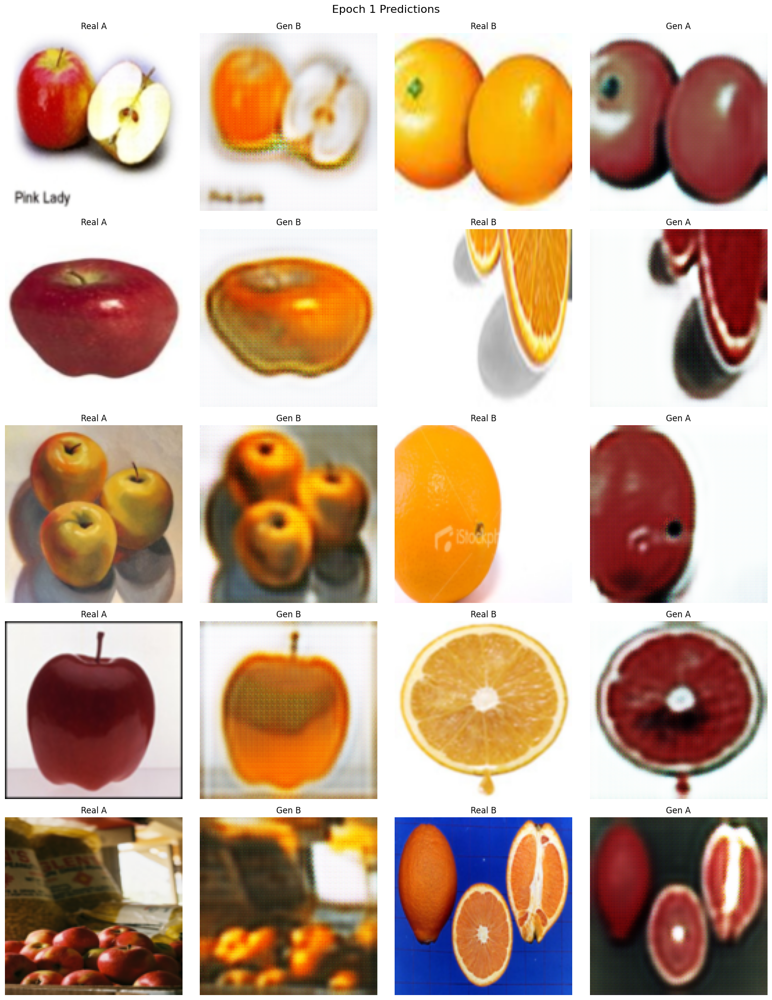

  0%|          | 0/1019 [00:00<?, ?it/s]

Epoch 2 | Cycle Loss: 4.3518


  0%|          | 0/1019 [00:00<?, ?it/s]

Epoch 3 | Cycle Loss: 3.9438


  0%|          | 0/1019 [00:00<?, ?it/s]

Epoch 4 | Cycle Loss: 3.7269


  0%|          | 0/1019 [00:00<?, ?it/s]

Epoch 5 | Cycle Loss: 3.5572


  0%|          | 0/1019 [00:00<?, ?it/s]

Epoch 6 | Cycle Loss: 3.4479


  0%|          | 0/1019 [00:00<?, ?it/s]

Epoch 7 | Cycle Loss: 3.3380


  0%|          | 0/1019 [00:00<?, ?it/s]

Epoch 8 | Cycle Loss: 3.2622


  0%|          | 0/1019 [00:00<?, ?it/s]

Epoch 9 | Cycle Loss: 3.1100


  0%|          | 0/1019 [00:00<?, ?it/s]

Epoch 10 | Cycle Loss: 3.0643


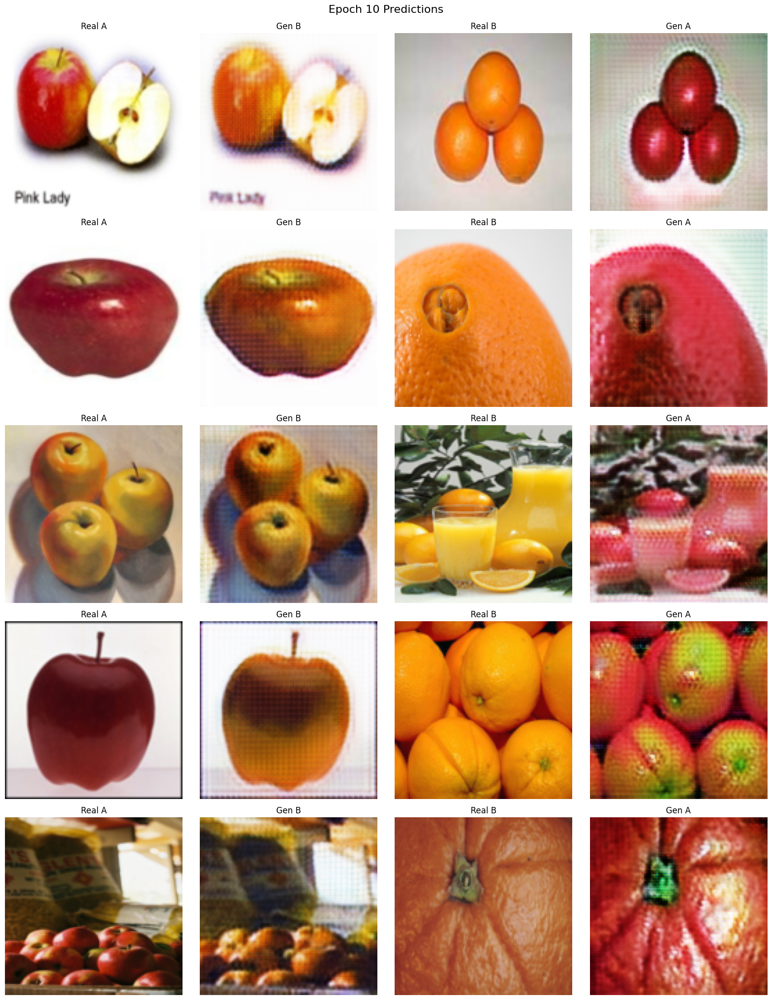

  0%|          | 0/1019 [00:00<?, ?it/s]

Epoch 11 | Cycle Loss: 2.9834


  0%|          | 0/1019 [00:00<?, ?it/s]

Epoch 12 | Cycle Loss: 2.9543


  0%|          | 0/1019 [00:00<?, ?it/s]

Epoch 13 | Cycle Loss: 2.9026


  0%|          | 0/1019 [00:00<?, ?it/s]

Epoch 14 | Cycle Loss: 2.8246


  0%|          | 0/1019 [00:00<?, ?it/s]

Epoch 15 | Cycle Loss: 2.8024


  0%|          | 0/1019 [00:00<?, ?it/s]

Epoch 16 | Cycle Loss: 2.7516


  0%|          | 0/1019 [00:00<?, ?it/s]

Epoch 17 | Cycle Loss: 2.6882


  0%|          | 0/1019 [00:00<?, ?it/s]

Epoch 18 | Cycle Loss: 2.6983


  0%|          | 0/1019 [00:00<?, ?it/s]

Epoch 19 | Cycle Loss: 2.6576


  0%|          | 0/1019 [00:00<?, ?it/s]

Epoch 20 | Cycle Loss: 2.6241


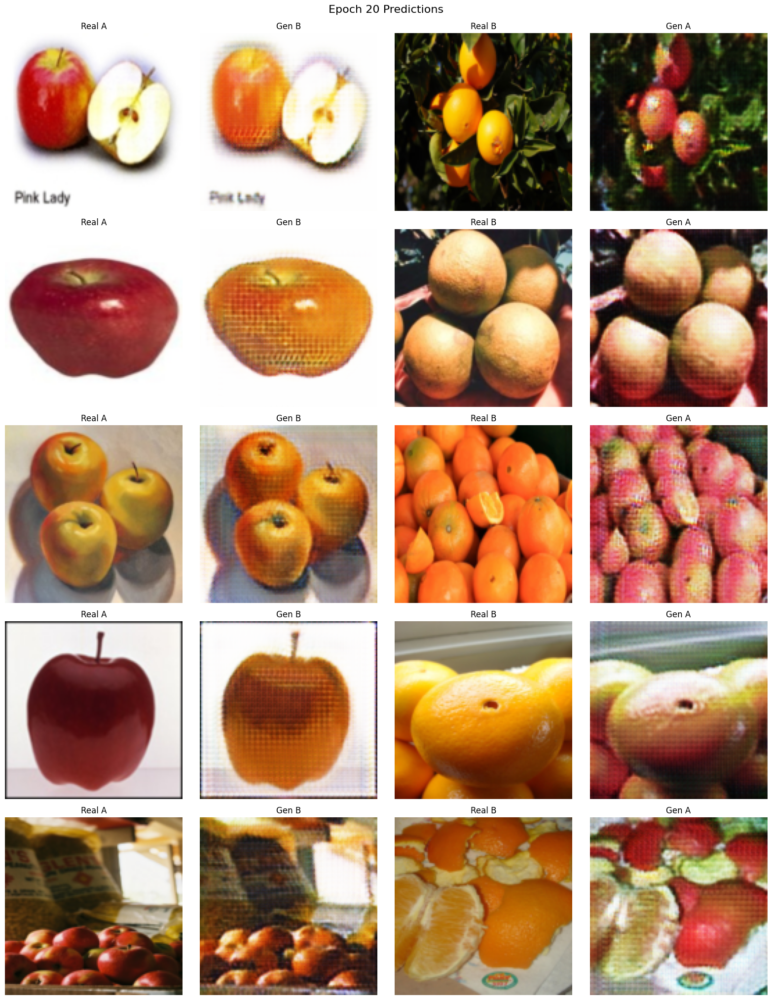

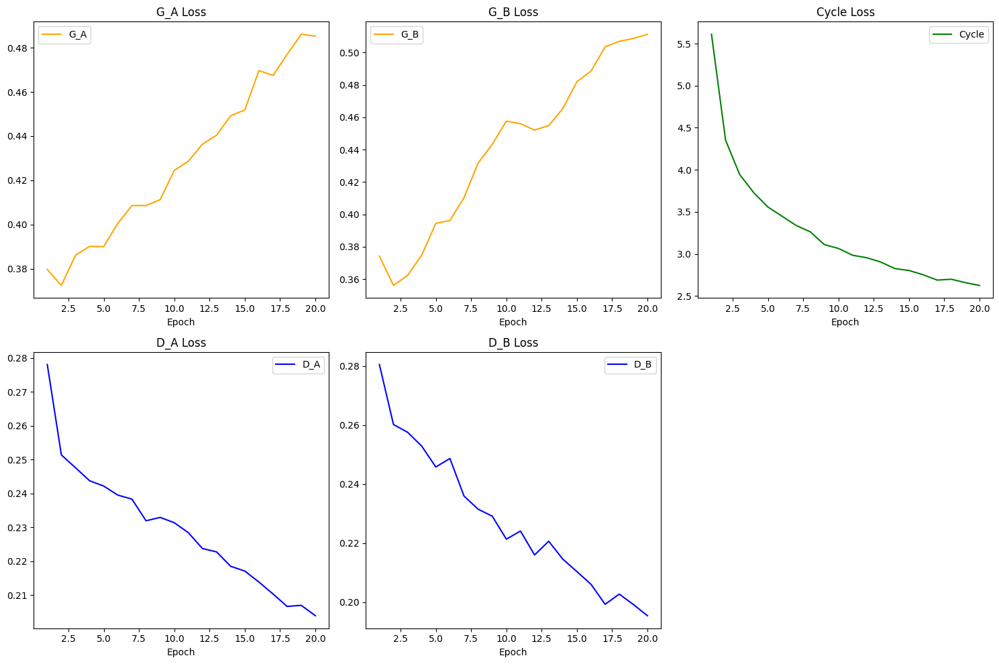

Saved apple2orange model!


In [25]:
config = get_config("apple2orange")

transform = transforms.Compose([
    transforms.Resize((config["IMG_SIZE"], config["IMG_SIZE"])),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
])

train_ds = CycleGANDataset(config["TRAIN_DIR"], transform=transform, mode='train')
val_ds = CycleGANDataset(config["TRAIN_DIR"], transform=transform, mode='test')

if len(train_ds) == 0:
    print(f"ERROR: No images found at {config['TRAIN_DIR']}. Check dataset path!")
else:
    print(f"Loaded {len(train_ds)} images.")
    
    print("Visualizing Raw Dataset Samples...")
    show_raw_samples(train_ds, num_samples=5)
    
    train_loader = DataLoader(train_ds, batch_size=config["BATCH_SIZE"], shuffle=True, num_workers=config["NUM_WORKERS"], pin_memory=True)
    val_loader = DataLoader(val_ds, batch_size=1, shuffle=False, pin_memory=True)
    
    history, gen_B, gen_A = run_training(config, train_loader, val_loader)

    plot_five_diagrams(history)
    
    torch.save(gen_B.state_dict(), "gen_Orange.pth") 
    torch.save(gen_A.state_dict(), "gen_Apple.pth") 
    print("Saved apple2orange model!")

### **Results:**
note that the original paper ran for 200 epochs, but here because the gpu resources were limited, I only ran it for 20 epochs, if we were to give it more time as explained in diagram analysis, generator would become stronger in fooling the discriminator and would've got even a better result.

#### **A. Generated Images**

**Epoch 1**
* The generated images look nearly identical to the original inputs, or they contain significant noise and random color splotches
(the bottom right picture converted a blue background to a black one!).

* At this early stage, the Generator weights are essentially random. The Discriminator has not yet learned to distinguish between "Real Oranges" and "Fake Oranges," so the Generator has received little to no meaningful feedback. The Cycle Consistency loss ($Rec_A \approx A$) dominates, encouraging the model to output the input image unchanged (Identity mapping).

**Epoch 10**
* We begin to see distinct color shifts.
    * **Apple $\to$ Orange:** The red surface of apples starts turning yellow/orange.
    * **Orange $\to$ Apple:** The orange peel texture starts smoothing out and reddening.
* The model is learning the global color distribution but lacks precision. we can see the edges between the fruit and the background are blurry. 

**Epoch 20**
* The translation is more robust.
    * Apples appear uniformly orange. The model successfully identifies the "object" (fruit) vs. the "background" (e.g. upper right it leaves the tree alone).
    * The texture of oranges is appearing on the generated apples.
* Background Preservation: green leaves remain green, this proves that the **Cycle Consistency Loss** ($\lambda_{cyc}$) and **Identity Loss** ($\lambda_{id}$) are working. If the leaves turned orange, it would indicate the model failed to separate the object from the domain style.

#### **B. Loss Diagram**

**Cycle Consistency Loss (Green Curve)**

Consistently decreasing. A decreasing curve confirms that the mappings $F(G(x)) \approx x$ are improving. The model is learning to not just "fool" the discriminator, but to retain the structural information required to reconstruct the original image.

**Adversarial Losses (Generator vs. Discriminator)**
* **Discriminator Loss ($D_A, D_B$ - Blue):** fluctuates or slowly decrease.
* **Generator Loss ($G_A, G_B$ - Orange):** fluctuates or slowly increases.
* **Interpretation:** This asymmetry is common in GANs. It is easier for the Discriminator to spot a fake (by detecting artifacts or blurriness) than it is for the Generator to create a perfect forgery. For short training runs a "winning" discriminator is to be expected, if we were to continue training generator would become stronger and was capable of fooling the discriminator.

The model has successfully learned to perform unpaired image-to-image translation. It correctly identifies the semantic object (fruit) and swaps the color palette (Red $\leftrightarrow$ Orange) while preserving the geometric structure and background context.

## 8. Summer2Winter


Loaded 1231 images.
Visualizing Raw Dataset Samples...


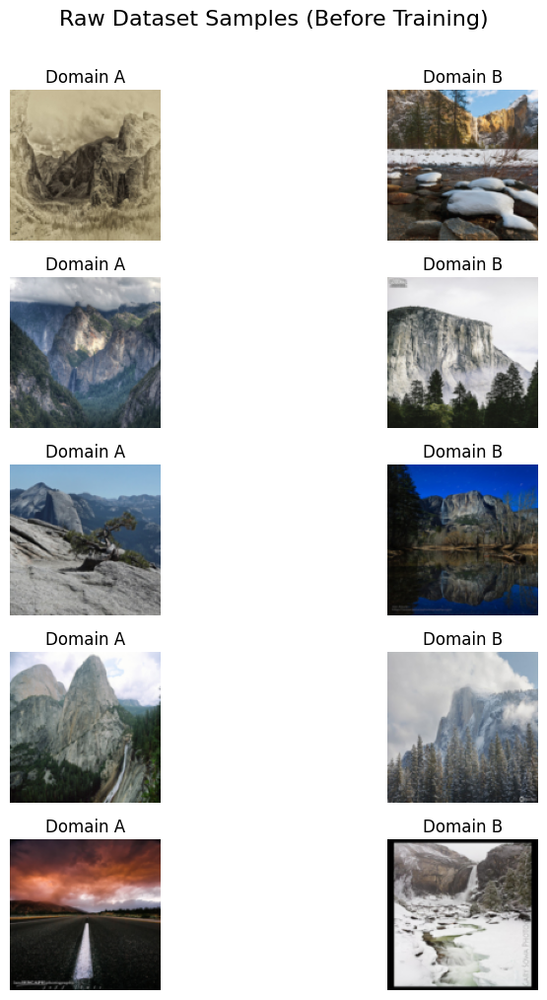

Starting Training on /kaggle/input/summer2winter-yosemite...


/tmp/ipykernel_47/2390134110.py:36: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  g_scaler = torch.cuda.amp.GradScaler()
/tmp/ipykernel_47/2390134110.py:37: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  d_scaler = torch.cuda.amp.GradScaler()


  0%|          | 0/1231 [00:00<?, ?it/s]

/tmp/ipykernel_47/2871812625.py:11: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast():
/tmp/ipykernel_47/2871812625.py:32: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast():


Epoch 1 | Cycle Loss: 5.0139


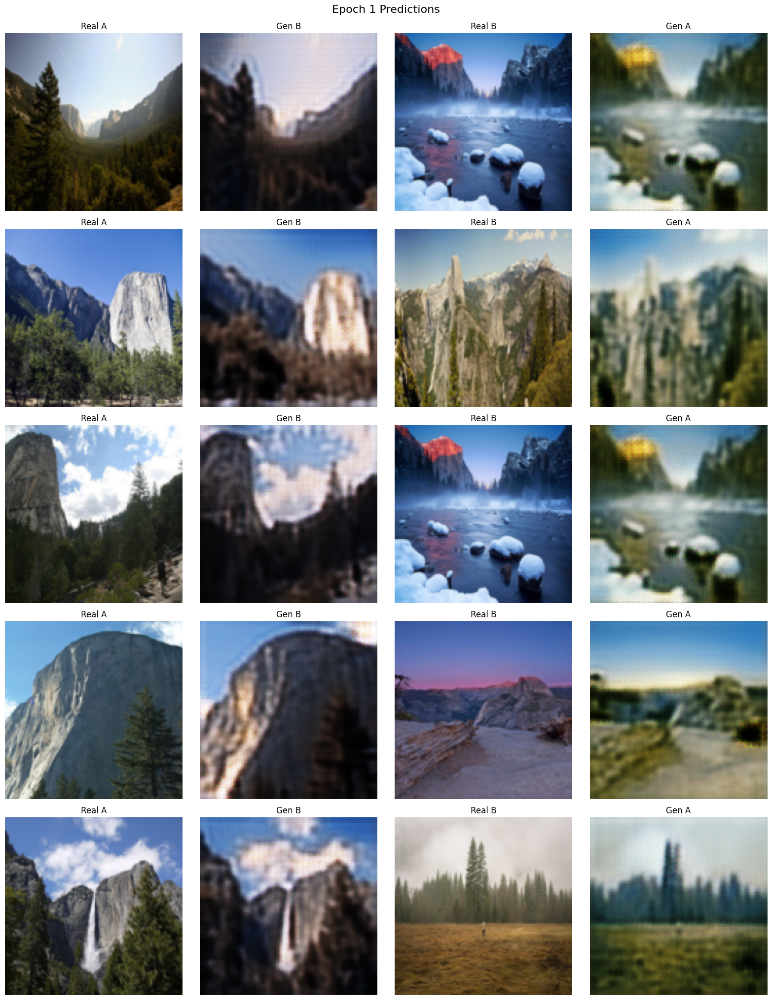

  0%|          | 0/1231 [00:00<?, ?it/s]

Epoch 2 | Cycle Loss: 3.9420


  0%|          | 0/1231 [00:00<?, ?it/s]

Epoch 3 | Cycle Loss: 3.6502


  0%|          | 0/1231 [00:00<?, ?it/s]

Epoch 4 | Cycle Loss: 3.4674


  0%|          | 0/1231 [00:00<?, ?it/s]

Epoch 5 | Cycle Loss: 3.3284


  0%|          | 0/1231 [00:00<?, ?it/s]

Epoch 6 | Cycle Loss: 3.1540


  0%|          | 0/1231 [00:00<?, ?it/s]

Epoch 7 | Cycle Loss: 3.0625


  0%|          | 0/1231 [00:00<?, ?it/s]

Epoch 8 | Cycle Loss: 2.9629


  0%|          | 0/1231 [00:00<?, ?it/s]

Epoch 9 | Cycle Loss: 2.8746


  0%|          | 0/1231 [00:00<?, ?it/s]

Epoch 10 | Cycle Loss: 2.8056


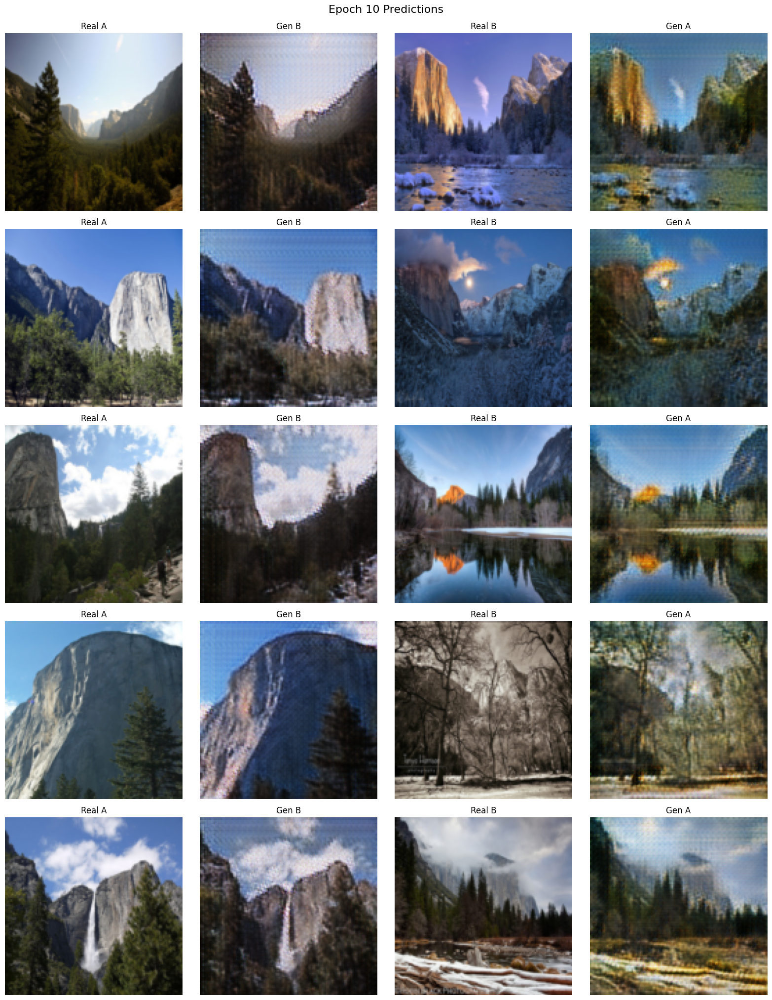

  0%|          | 0/1231 [00:00<?, ?it/s]

Epoch 11 | Cycle Loss: 2.7063


  0%|          | 0/1231 [00:00<?, ?it/s]

Epoch 12 | Cycle Loss: 2.6401


  0%|          | 0/1231 [00:00<?, ?it/s]

Epoch 13 | Cycle Loss: 2.5991


  0%|          | 0/1231 [00:00<?, ?it/s]

Epoch 14 | Cycle Loss: 2.5188


  0%|          | 0/1231 [00:00<?, ?it/s]

Epoch 15 | Cycle Loss: 2.5004


  0%|          | 0/1231 [00:00<?, ?it/s]

Epoch 16 | Cycle Loss: 2.4262


  0%|          | 0/1231 [00:00<?, ?it/s]

Epoch 17 | Cycle Loss: 2.4036


  0%|          | 0/1231 [00:00<?, ?it/s]

Epoch 18 | Cycle Loss: 2.3595


  0%|          | 0/1231 [00:00<?, ?it/s]

Epoch 19 | Cycle Loss: 2.3229


  0%|          | 0/1231 [00:00<?, ?it/s]

Epoch 20 | Cycle Loss: 2.2748


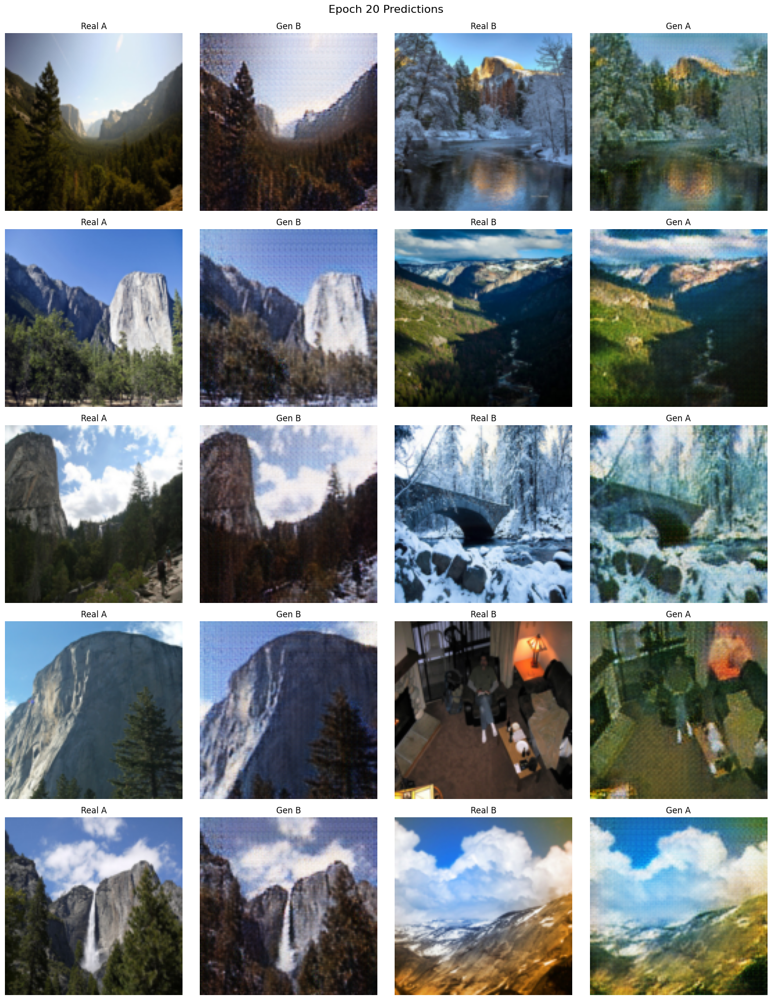

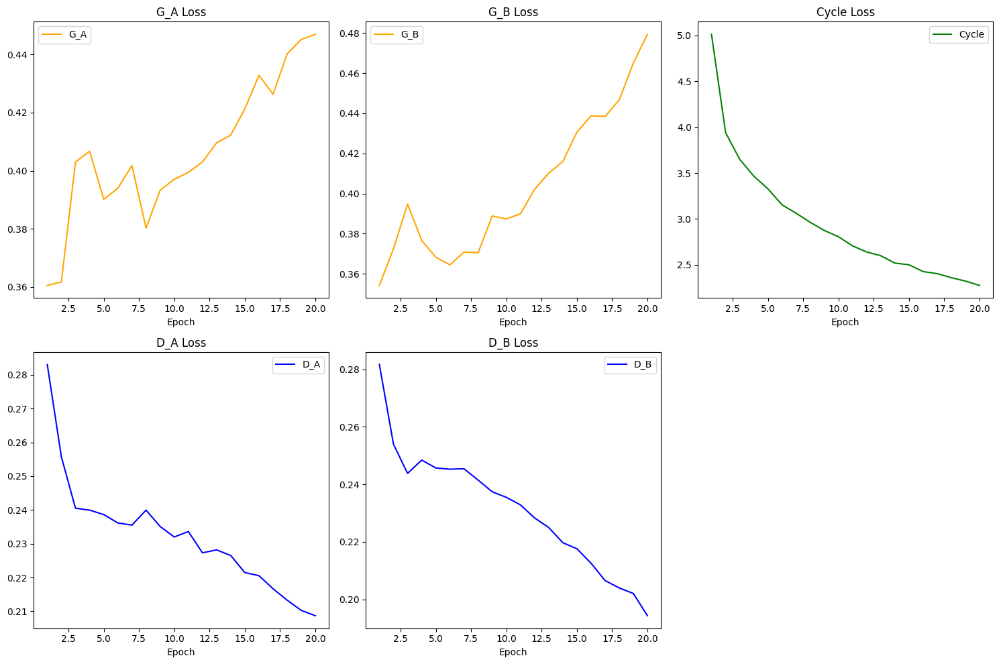

Saved summer2winter model!


In [26]:
try: del gen_A, gen_B, history, train_loader, val_loader
except: pass
gc.collect(); torch.cuda.empty_cache()

summer_config = get_config("summer2winter")
train_ds_sw = CycleGANDataset(summer_config["TRAIN_DIR"], transform=transform, mode='train')
val_ds_sw = CycleGANDataset(summer_config["TRAIN_DIR"], transform=transform, mode='test')

if len(train_ds_sw) == 0:
    print(f"ERROR: No images found at {summer_config['TRAIN_DIR']}.")
else:
    print(f"Loaded {len(train_ds_sw)} images.")
    
    print("Visualizing Raw Dataset Samples...")
    show_raw_samples(train_ds_sw, num_samples=5)

    train_loader_sw = DataLoader(train_ds_sw, batch_size=summer_config["BATCH_SIZE"], shuffle=True, num_workers=summer_config["NUM_WORKERS"], pin_memory=True)
    val_loader_sw = DataLoader(val_ds_sw, batch_size=1, shuffle=False, pin_memory=True)
    hist_sw, gen_W, gen_S = run_training(summer_config, train_loader_sw, val_loader_sw)

    plot_five_diagrams(hist_sw)
    torch.save(gen_W.state_dict(), "gen_winter.pth")
    torch.save(gen_S.state_dict(), "gen_summer.pth")
    print("Saved summer2winter model!")

### **Results:**

#### **A. Generated Images**

The progression of the generated images from Epoch 1 to Epoch 20 reveals specific learning behaviors:

* The most distinct feature of this transformation is the replacement of green foliage with white snow textures.
* By Epoch 20, the model successfully identifies "grassy" regions and tints them white/grey. It distinguishes between "sky" (which remains blue/grey) and "ground" (which turns white), demonstrating that the semantic segmentation implicit in CycleGAN is working.
* In dense summer forests, the "winter" generator occasionally applies a simple white filter rather than removing the leaves entirely. This is a known limitation of CycleGAN, it is a texture-transfer model, not a geometry-modification model. It cannot easily "delete" leaves, so it paints them white instead.

* Cycle Consistency:
    * The rock formations and mountain ridges in the background remain sharp and structurally identical to the input.
    * This indicates that the **Cycle Consistency Loss** is effectively preventing the generator from hallucinating new mountains or distorting the horizon line.

* Some "checkerboard" artifacts may be visible in the sky regions. This is a common byproduct of the *ConvTranspose2d* layers used in the upsampling block of the Generator.

#### **B. Loss Diagram**

* **Cycle Loss Trend:**
 
    The consistent decrease in Cycle Loss confirms that the mappings $G$ and $F$ are becoming increasingly bijective (invertible). The model is learning to embed the "Summer" information into the "Winter" image well enough to reconstruct it back, which is why the details of the trees and rocks are preserved.

* **Adversarial Loss:**

    The Discriminator and Generator losses oscillate rather than decreasing monotonically. This is expected behavior for GANs. It implies a stable "min-max" game where neither network is overpowering the other.
